# The Butterfly Effect

# Key Findings

__From notebook 1:__

# Data Preparation

## Imports

In [1]:
# Base packages
import pandas as pd
import numpy as np

# Data viz
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Stats
from scipy import stats
import statsmodels.api as sm

# Scaler
from sklearn.preprocessing import MinMaxScaler

# Time Series - SARIMA
import pmdarima as pm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Time Series - VAR
from statsmodels.api import tsa
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.api import VAR

# Time Series - PROPHET
from prophet import Prophet
from prophet.plot import plot_plotly
from prophet.utilities import regressor_coefficients
from statsmodels.tsa.vector_ar.vecm import coint_johansen

# Ignore futurewarnings
import warnings
warnings.filterwarnings('ignore')

## D1 - London Butterfly sightings / Traits / Vulnerable Species

The Butterfly dataset used here is:

- __From__: a merge done in the '1_Butterflies_EDA.ipynb' notebook among three datasets:
    - UKBMS Butterfly sightings (https://nbnatlas.org/)
    - LepTraits dataset (https://github.com/RiesLabGU/LepTraits/)
    - Endangered species dataset (https://butterfly-conservation.org/red-list-of-butterflies-in-great-britain)
- __Content__: a collection of butterfly sightings gathered by the UKBMS (United Kingdom Butterfly Monitoring Scheme), and is _one of the longest running insect monitoring schemes in the world_, including butterfly Traits and the vulnerability of the species (for example: endangered species). The sightings located in London have been extracted in the notebook '1_Butterflies_EDA.ipynb'
- __1 row equals__: 1 butterfly sighting (for example: one monarch, at this location, on that day)
- __Period__: 2001 - 2020
<br>
<br>

__Data Dictionnary__:

|#| Column Name | Type | Description |
|:--|:--|:--|:--|
|0|`Sightings`|Numerical|Number of butterflies counted in London for a particular month
|1|`NumSurveys`|Numerical|Number of surveys in London for a particular month
|2|`Butterflies_per_Survey`|Numerical|Average number of butterflies per survey counted in London for a particular month
|3|`Order`|Numerical|Sequential number from 1 to 240
|4|`Trend`|Numerical|From Seasonal decompose
|5|`Seasonal`|Numerical|From Seasonal decompose
|6|`Residuals`|Numerical|From Seasonal decompose

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
Sightings_Surveys = pd.read_csv('data/4.Sightings_Surveys_London.csv')

In [4]:
Sightings_Surveys.head()

,Unnamed: 0,Sightings,NumSurveys,Butterflies_per_Survey,Order,Trend,Seasonal,Residuals
0,2001-01-01,0.0,0.0,0.0000,0,NaN,-7.321387,NaN
1,2001-02-01,0.0,0.0,0.0000,1,NaN,-7.327164,NaN
2,2001-03-01,0.0,0.0,0.0000,2,NaN,-5.184103,NaN
3,2001-04-01,111.0,13.0,8.5385,3,NaN,2.544830,NaN
4,2001-05-01,262.0,22.0,11.9091,4,NaN,3.284393,NaN


In [5]:
# Dropping Unnamed: 0 column (aka remainder of CSV import, no useful information)
Sightings_Surveys = Sightings_Surveys.drop(columns='Unnamed: 0')

In [6]:
Sightings_Surveys.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Sightings               240 non-null    float64
 1   NumSurveys              240 non-null    float64
 2   Butterflies_per_Survey  240 non-null    float64
 3   Order                   240 non-null    int64  
 4   Trend                   228 non-null    float64
 5   Seasonal                240 non-null    float64
 6   Residuals               228 non-null    float64
dtypes: float64(6), int64(1)
memory usage: 13.3 KB


In [7]:
print(f'D1 has {Sightings_Surveys.shape[0]} rows and {Sightings_Surveys.shape[1]} columns')

D1 has 240 rows and 7 columns


## D2 - Weather info

__COMMENT__: This dataset is:

- __Content__: Monthly weather information from Heathrow (London Airport)
- __1 row equals__: one month
- __Period__: 1948 - 2024
- __From__: https://www.metoffice.gov.uk/research/climate/maps-and-data/historic-station-data

Estimated data is marked with a *.

In [8]:
df_london_weather = pd.read_fwf('data/5.heathrowdata.txt')

In [9]:
df_london_weather.head()

,yyyy,mm,tmax,tmin,af,rain,sun
0,1948,1,8.9,3.3,---,85.0,---
1,1948,2,7.9,2.2,---,26.0,---
2,1948,3,14.2,3.8,---,14.0,---
3,1948,4,15.4,5.1,---,35.0,---
4,1948,5,18.1,6.9,---,57.0,---


__Data Dictionnary__:

|#| Column Name | Type | Description |
|:--|:--|:--|:--|
|0|`yyyy`|Numerical|Year
|1|`mm`|Numerical|Month
|2|`tmax`|Numerical|Mean daily maximum temperature (tmax) in Celsius
|3|`tmin`|Numerical|Mean daily minimum temperature (tmin) in Celsius
|4|`af`|Numerical|Days of air frost
|5|`rain`|Numerical|Total rainfall in mm
|6|`sun`|Numerical|Total sunshine duration in hours

Missing data (more than 2 days missing in month) is marked by  '---'.

In [10]:
print(f'D2 has {df_london_weather.shape[0]} rows and {df_london_weather.shape[1]} columns')

D2 has 914 rows and 7 columns


## D3 - Air Quality info

__COMMENT__: This dataset is:

- __Content__: Hourly air quality information from Marylebone road (center London) - station with the most data points
- __1 row equals__: 1 hour
- __Period__: 2001-2020
- __From__: https://www.londonair.org.uk/LondonAir/Default.aspx

__Data Dictionnary__:
|#| Column Name | Type | Description |
|:--|:--|:--|:--|
|0|`code`|Text|Station code
|1|`date`|datetime|Date
|2|`O3`|Numerical|Ground Level Ozone
|3|`NO2`|Numerical|Nitrogen Dioxide
|4|`NOXasNO2`|Numerical|Nitrogen Dioxide
|5|`SO2`|Numerical|Sulphur dioxide
|6|`CO`|Numerical|Carbon Monoxide
|7|`PM10`|Numerical|Particles
|8|`site`|Text|Site name

In [11]:
london_AQ_W = pd.read_csv('data/6.Air_Quality_London_Marylebone_Road.csv')
london_AQ_W.head()

,code,date,O3,NO2,NOXasNO2,SO2,CO,PM10,site
0,MY1,2001-01-01 00:00:00,10.0,59.0,225.0,5.0,2.0,27.0,London Marylebone Road
1,MY1,2001-01-01 01:00:00,6.0,67.0,290.0,8.0,2.7,26.0,London Marylebone Road
2,MY1,2001-01-01 02:00:00,4.0,76.0,456.0,13.0,4.3,35.0,London Marylebone Road
3,MY1,2001-01-01 03:00:00,4.0,69.0,384.0,11.0,3.2,34.0,London Marylebone Road
4,MY1,2001-01-01 04:00:00,10.0,52.0,235.0,8.0,1.9,30.0,London Marylebone Road


In [12]:
print(f'D3 has {london_AQ_W.shape[0]} rows and {london_AQ_W.shape[1]} columns')

D3 has 175320 rows and 9 columns


# Model 1 : SARIMA

## Train / Test Split

__COMMENT:__ We are splitting the dataset 75/25% (aka 75% of all the rows = 180 datapoints), in chronological order.

In [13]:
# Defining % of data points in the test sets (25%)
nobs = int(len(Sightings_Surveys) - len(Sightings_Surveys)*0.25)

# Creating train and test sets
train = Sightings_Surveys['Butterflies_per_Survey'].iloc[:nobs]
print(f'Train set shape: {train.shape[0]} rows')

test = Sightings_Surveys['Butterflies_per_Survey'].iloc[nobs:]
print(f'Test set shape: {test.shape[0]} rows')

Train set shape: 180 rows
Test set shape: 60 rows


## Finding best parameters

__COMMENT:__ For the SARIMA model, we need to assess the best following parameters:

- p: Trend autoregression order - found with PACF plot (points above the blue zone)
- d: Trend difference order - as we have a seasonality here, the differencing done to get a stationary timeline should be enough 
- q: Trend moving average order - found with ACF plot (see sharp drop in ACF plot)
- P: Seasonal autoregressive order
- D: Seasonal difference order
- Q: Seasonal moving average order
- S: The number of time steps for a single seasonal period

Our timeline will also need to be stationary so increase the model's performance.

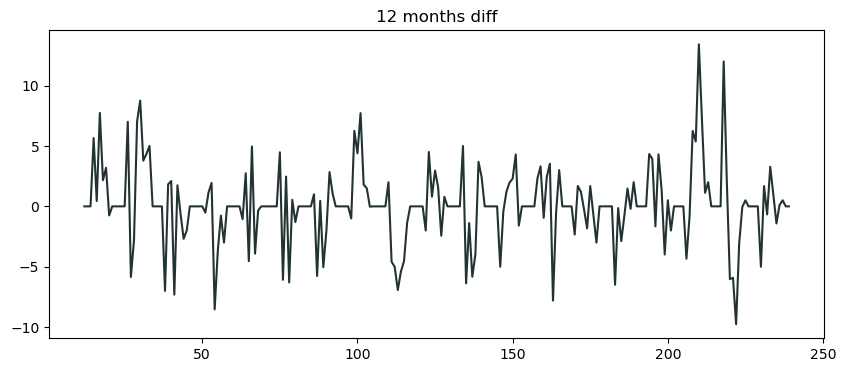

In [14]:
# Stationarity
Sightings_Surveys['Year_Diff_12'] = Sightings_Surveys['Butterflies_per_Survey'].diff(12)

# Plot
plt.figure(figsize=(10,4))
plt.plot(Sightings_Surveys['Year_Diff_12'], color='#233333')
plt.title('12 months diff')
plt.show()

In [15]:
# Testing stationarity
DickeyFullerTest_12 = adfuller(Sightings_Surveys['Year_Diff_12'].dropna())
print('Statistic Test : ', round(DickeyFullerTest_12[0], 2))
print('p-value : ', round(DickeyFullerTest_12[1],4))

Statistic Test :  -4.74
p-value :  0.0001


__COMMENT:__ The data is now stationary.

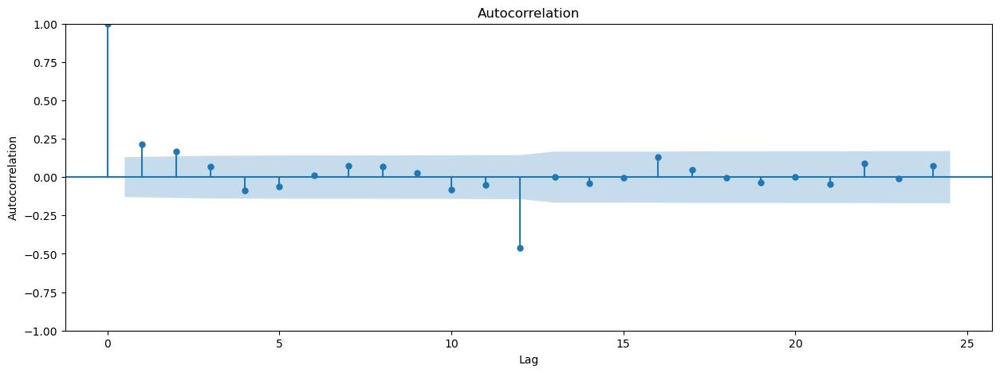

In [16]:
# Finding q
plt.figure(figsize=(15, 5))
plot_acf(Sightings_Surveys['Year_Diff_12'].dropna(), lags=24, ax=plt.gca())
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

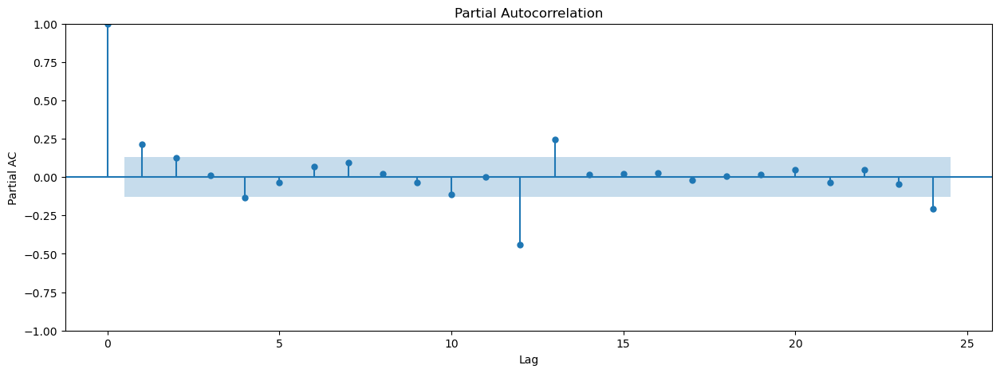

In [17]:
# Finding p
plt.figure(figsize=(15, 5))
plot_pacf(Sightings_Surveys['Year_Diff_12'].dropna(), lags=24, ax=plt.gca(), method='ywm')
plt.xlabel('Lag')
plt.ylabel('Partial AC')
plt.show()

__COMMENT:__ Given the ACF and PCAF plots above we can infer that the best parameters would be:

- p: 1
- d: 0
- q: 2
- m: 12 for the yearly seasonality

To confirm this intuition, we will also run an auto_arima function which will look through the best combos possible and select the one with the lowest AIC.

In [18]:
# model_test = pm.auto_arima(train, m = 12, D=1, seasonal = True, trace = True)
# model_test.summary()

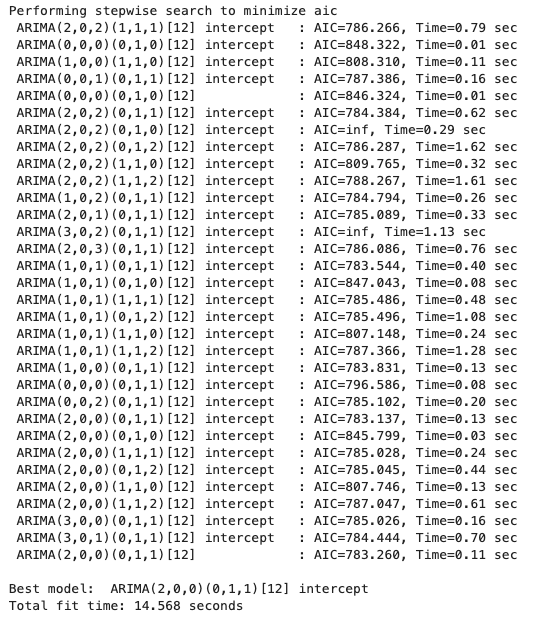

__COMMENT:__ The results are different from our intuition, however, the AIC for 1,0,2 values was very close to the one with the best parameters. We will proceed with the parameters from auto_arima.

## Model

In [19]:
# Model
sarima = SARIMAX(train, order=(2, 0, 0), seasonal_order=(0, 1, 1, 12), trend='c')
sarima_fit = sarima.fit(disp=0)
sarima_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:               Butterflies_per_Survey   No. Observations:                  180
Model:             SARIMAX(2, 0, 0)x(0, 1, [1], 12)   Log Likelihood                -386.568
Date:                              Fri, 26 Apr 2024   AIC                            783.137
Time:                                      08:33:55   BIC                            798.756
Sample:                                           0   HQIC                           789.476
                                              - 180                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     -0.0827      0.065     -1.263      0.206      -0.211       0.046
ar.L1          0.2557      0.056      4.572      0.000       0.146       0.365
ar.L2          0.1265      0.077      1.643      0.100      -0.024       0.277
ma.S.L12      -0.7950      0.061    -13.009      0.000      -0.915      -0.675
sigma2         5.4306      0.388     14.005      0.000       4.671       6.191
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                85.14
Prob(Q):                              0.95   Prob(JB):                         0.00
Heteroskedasticity (H):               0.53   Skew:                             0.79
Prob(H) (two-sided):                  0.02   Kurtosis:                         6.11
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

## Evaluation

In [20]:
# Evaluation - First defining a function to calculate the Mean Absolute Percentage Error (will serve to evaluate scores across models)
def mean_absolute_percentage_error(true_values, predicted_values):
    """
    Calculate the mean absolute percentage error. 
    Find the prediction error and devide by the true value, then average.
    """
    
    absolute_percentage_error = []

    for x, y in zip(true_values, predicted_values):
        error = x - y
        
        # Some true values in our dataset are = to 0 (months where there are no sightings), this is to avoid errors due to dividing by 0
        if x == 0:
            absolute_percentage_error.append(0)
        else: absolute_percentage_error.append(np.abs(error/x))

    mape = np.mean(absolute_percentage_error) * 100

    return mape

# Evaluation - Defining a function to calculate difference between MAPE train and MAPE test
def Diff_MAPE_calculation(train_mape, test_mape):
    return test_mape - train_mape

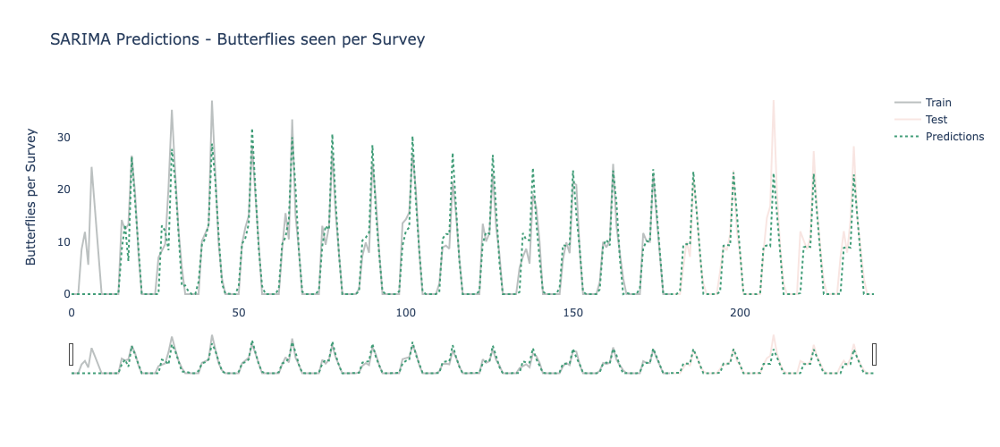

Trendline predictions coeff: -0.0007


Train MAPE on the difference: 15.28%
Test MAPE on the difference: 20.78%
Difference in accuracy between train and test sets: 5.5%


In [21]:
# Predicting with SARIMA model
predictions_sarima = sarima_fit.predict(start=0, end=len(train)+len(test))

# Add Order info for linear regression
predictions_sarima_df = pd.DataFrame(predictions_sarima) 
predictions_sarima_df['Order'] = range(len(predictions_sarima_df))

# Make sure no predictions are below 0 (not possible)
predictions_sarima_df['predicted_mean'] = np.where(predictions_sarima_df['predicted_mean'] < 0, 0, predictions_sarima_df['predicted_mean'])

#Get Trendline
X = predictions_sarima_df['Order']
y = predictions_sarima_df['predicted_mean']
Trendline = sm.OLS(y.values, sm.add_constant(X.values), missing='drop').fit()

# Plotting True values and Predictions
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', line=dict(color='#233333'), name='Train', opacity=0.3))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', line=dict(color='#EBACA0'), name='Test', opacity=0.3))
fig.add_trace(go.Scatter(x=predictions_sarima_df.index, y=predictions_sarima_df['predicted_mean'], mode='lines', line_dash='dot', 
                         line=dict(color='#419D78'), name='Predictions'))

fig.update_xaxes(rangeslider_visible=True)

fig.update_layout(yaxis_title='Butterflies per Survey',
                  title='SARIMA Predictions - Butterflies seen per Survey',
                  width=1100, height=500, plot_bgcolor='white', showlegend=True)
fig.show()
print(f'Trendline predictions coeff: {round(Trendline.params[1],4)}')
print('\n')

# Evaluation - Models Results
split_index = pd.DataFrame(test).index[0]
train_mape = mean_absolute_percentage_error(train, predictions_sarima_df.loc[:split_index,'predicted_mean'])
test_mape = mean_absolute_percentage_error(test, predictions_sarima_df.loc[split_index:,'predicted_mean'])
Diff_MAPE = Diff_MAPE_calculation(train_mape, test_mape)

print(f'Train MAPE on the difference: {round(train_mape, 2)}%')
print(f'Test MAPE on the difference: {round(test_mape, 2)}%')
print(f'Difference in accuracy between train and test sets: {round(Diff_MAPE, 2)}%')

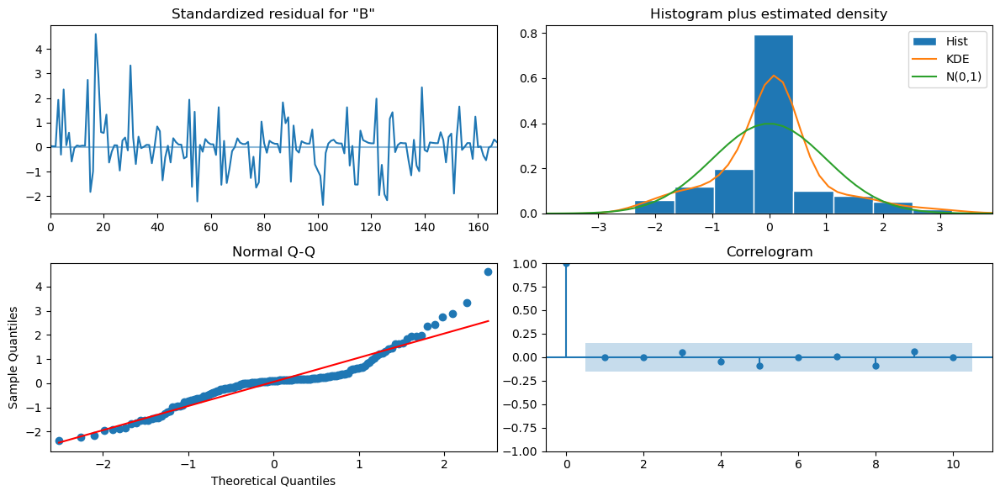

In [22]:
# Evaluation - Plot residuals
sarima_fit.plot_diagnostics(figsize=(12,6))
plt.tight_layout()
plt.show()

__COMMENT:__ The results are not bad! The difference in accuracy measured with MAPE is around 5% which is pretty good: the model seems to have captured the overall trend of the timeline and do not overfit.

However, it is important to note that the predictions over the test set are somewhat constant. The predictions did not pick up on the 2018 peak and the 5 years in the test set look somewhat the same.

The residuals analysis however shows that the model is robust: 

- no pattern in the standardized residuals
- the residuals histogram looks like a normal distribution
- most of the points in the QQ plot are on the red line
- no significant autocorrelation in the residuals

# Model 2: VAR

__COMMENT:__ We will now try to mix our external factors to see if they can help in predicting the butterfly population evolution estimation. We start with a VAR model:

## EDA and Data Preprocessing

### Preprocess D2

In [23]:
# Create Year/Month column in datetime format 
df_london_weather['Year'] = df_london_weather['yyyy'].apply(lambda x: pd.to_datetime(str(x), format='mixed')).dt.year
df_london_weather['Month'] = df_london_weather['mm'].apply(lambda x: pd.to_datetime(str(x), format='%m')).dt.month
df_london_weather['Day'] = '01'
df_london_weather['Year_Month'] = pd.to_datetime(df_london_weather[['Year', 'Month', 'Day']])

# Drop redundant dates columns
df_london_weather = df_london_weather.drop(columns=['yyyy', 'mm', 'Year', 'Month', 'Day'])

# Set Year_Month as index
df_london_weather = df_london_weather.set_index('Year_Month')

In [24]:
# Drop information out of time range compared to D1 (2001-2020)
df_london_weather = df_london_weather.loc['2001-01-01':'2020-12-31',:]
df_london_weather.head(3)

,tmax,tmin,af,rain,sun
Year_Month,,,,,
2001-01-01,7.1,1.8,9,75.2,87.0
2001-02-01,9.2,2.8,5,69.6,92.3
2001-03-01,9.5,3.8,3,95.3,78.2


In [25]:
df_london_weather.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 240 entries, 2001-01-01 to 2020-12-01
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   tmax    240 non-null    float64
 1   tmin    240 non-null    float64
 2   af      240 non-null    object 
 3   rain    240 non-null    float64
 4   sun     240 non-null    object 
dtypes: float64(3), object(2)
memory usage: 11.2+ KB


In [26]:
# Change type for values in af and sun columns
df_london_weather['af'] = pd.to_numeric(df_london_weather['af'])
df_london_weather['sun'] = pd.to_numeric(df_london_weather['sun'])

In [27]:
# Checking for missing values (markes as '---' in this dataset)
cols = df_london_weather.columns

for col in cols:
    print(f"Missing value for {col}: {len(df_london_weather[df_london_weather[col] == '---'])}")

Missing value for tmax: 0
Missing value for tmin: 0
Missing value for af: 0
Missing value for rain: 0
Missing value for sun: 0


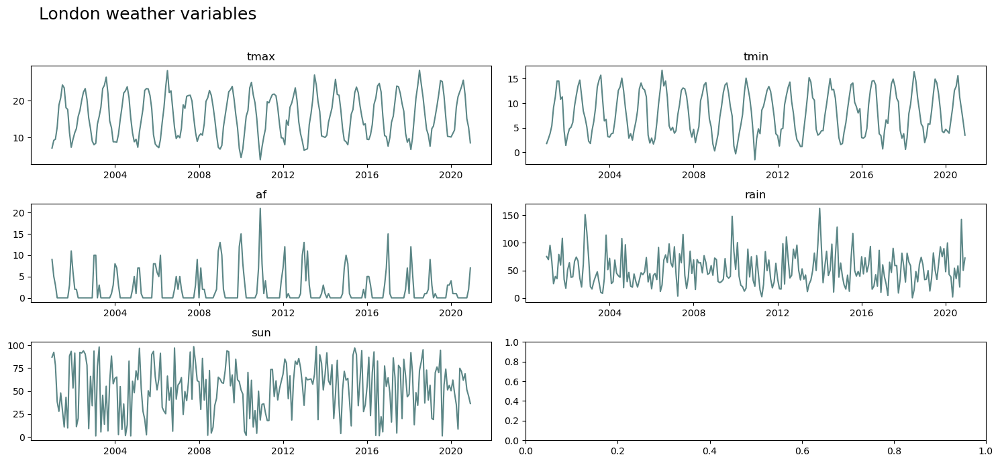

In [28]:
# Exploring data visually
cols = df_london_weather.columns

fig, axs = plt.subplots(3,2, figsize=(15,7))

for col, ax in zip(cols, axs.ravel()):
    ax.plot(df_london_weather[col], color='#5b8686')
    ax.set_title(f'{col}')

fig.suptitle('London weather variables\n', fontsize=18, x=0.15)
plt.tight_layout()
plt.show()

__COMMENT:__ Insights from first look at the data:

- Obvious seasonality for the temperatures variables which is of course not surprising.
- Frost: a peak in 2011 and drops in 2014 / 2016 / 2020
- Rain: pretty different over the months with no clear pattern, however we can see peaks in 2003, 2010, 2014 and 2020
- Sun: pretty different over the months with no clear pattern too

### Preprocess D3

In [29]:
# Passing date column to datetime
london_AQ_W['date'] = pd.to_datetime(london_AQ_W['date'])

# Dropping columns we won't be using
london_AQ_W = london_AQ_W.drop(columns=['code', 'NOXasNO2', 'site'])

In [30]:
# Check for duplicates
london_AQ_W .duplicated().sum()

0

In [31]:
# Set Date as index
london_AQ_W = london_AQ_W.set_index('date')

# Info for remaining columns
london_AQ_W.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 175320 entries, 2001-01-01 00:00:00 to 2020-12-31 23:00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   O3      166103 non-null  float64
 1   NO2     170727 non-null  float64
 2   SO2     165304 non-null  float64
 3   CO      162747 non-null  float64
 4   PM10    164878 non-null  float64
dtypes: float64(5)
memory usage: 8.0 MB


In [32]:
london_AQ_W.describe()

,O3,NO2,SO2,CO,PM10
count,166103.000000,170727.000000,165304.000000,162747.000000,164878.000000
mean,17.182022,92.500818,7.475406,0.753649,34.272568
std,16.725605,48.679070,6.281302,0.650823,20.515758
min,-2.000000,2.000000,-0.833840,0.000000,-3.000000
25%,4.000000,56.249100,3.000000,0.300000,19.800000
50%,11.624950,84.000000,5.208050,0.600000,30.000000
75%,24.447330,120.000000,11.000000,0.900000,44.300000
max,156.462880,403.000000,136.000000,22.900000,707.000000


In [33]:
# Get full_index and make sure we don't have any date missing
full_index = pd.date_range(start='2001-01-01 00:00:00', end='2020-12-31 23:00:00', freq='h')
diff_month = len(full_index.difference(london_AQ_W.index))
print(f'We have a difference of {diff_month} data entries over 20 years')

We have a difference of 0 data entries over 20 years


In [34]:
# Check if we have missing values
london_AQ_W.isna().sum()

O3       9217
NO2      4593
SO2     10016
CO      12573
PM10    10442
dtype: int64

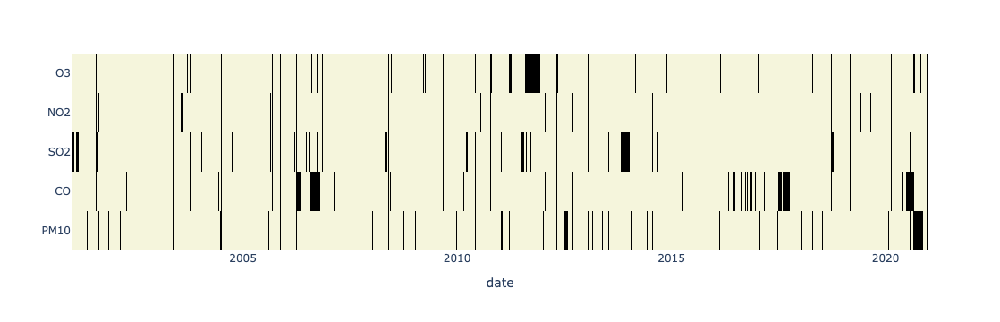

In [35]:
# See where the missing values are located
fig = px.imshow(london_AQ_W.isna().T, color_continuous_scale=['beige', 'black'], height=350, width=1100)
fig.update_layout(coloraxis_showscale=False)
fig.show()

__COMMENT:__ 

- Black = missing values
- Beige = Existing values

As we have missing values spread across the timeline, we will use a forward fill.

In [36]:
# Fill missing values
london_AQ_W = london_AQ_W.fillna(method='ffill')

In [37]:
# Resample
london_AQ_W = london_AQ_W.reset_index()
london_AQ_W = london_AQ_W.resample('MS', on='date').mean()
london_AQ_W.head()

,O3,NO2,SO2,CO,PM10
date,,,,,
2001-01-01,7.215054,85.311828,12.530914,2.214113,49.475806
2001-02-01,12.074405,90.629464,14.056548,1.972917,45.086310
2001-03-01,15.688172,91.723118,11.280914,1.826882,44.403226
2001-04-01,23.625000,87.854167,9.719444,1.722361,38.877778
2001-05-01,29.263441,76.803763,8.352151,1.324866,33.419355


In [38]:
# Drop information out of time range compared to D1 (2001-2020)
london_AQ_W.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 240 entries, 2001-01-01 to 2020-12-01
Freq: MS
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   O3      240 non-null    float64
 1   NO2     240 non-null    float64
 2   SO2     240 non-null    float64
 3   CO      240 non-null    float64
 4   PM10    240 non-null    float64
dtypes: float64(5)
memory usage: 11.2 KB


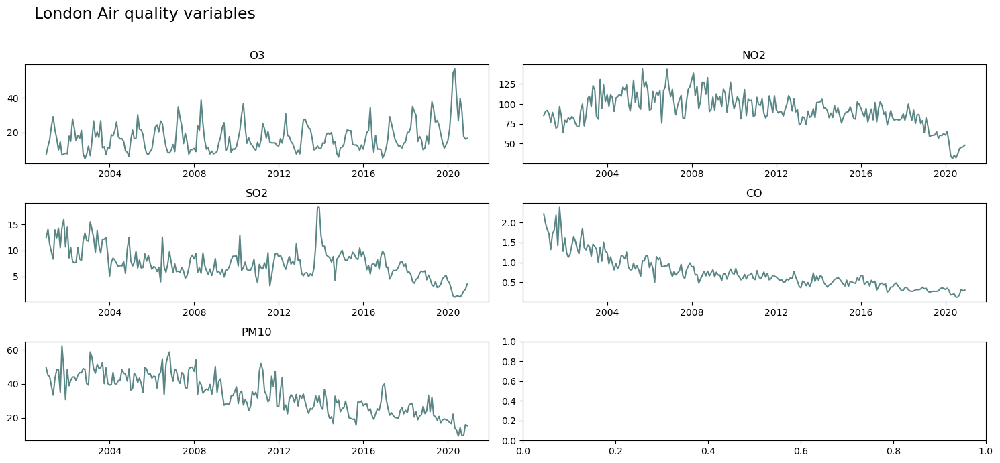

In [39]:
# Exploring data visually
cols = london_AQ_W.columns

fig, axs = plt.subplots(3,2, figsize=(15,7))

for col, ax in zip(cols, axs.ravel()):
    ax.plot(london_AQ_W[col], color='#5b8686')
    ax.set_title(f'{col}')

fig.suptitle('London Air quality variables \n', fontsize=17, x=0.15)
plt.tight_layout()
plt.show()

__COMMENT:__ Some insights for the pollutants observed here (from https://www.londonair.org.uk/LondonAir/guide/WhatIsPollution.aspx)

- O3: _'Almost no ozone is directly emitted by human activities, but it is __normally formed when other pollutants, including nitrogen dioxide, react in sunlight__. Therefore, on sunny days in polluted air concentrations of ozone can increase leading, in severe cases, to summertime "smog".'_

=> Clear seasonality (which is most likely linked to temperatures) and an upward trend with a sharp slope over the 3 last years.

- NO2: _'__Road transport__ is estimated to be responsible for about 50% of total emissions of nitrogen oxides'_

=> No evident seasonality here, downward trend over the years starting in 2008 and a sharp drop in 2020. This might be linked to the Low Emission Zone policies introduced in London in 2008 and 2019

- SO2: _'Produced when a material, or fuel, containing sulphur is burned. In the UK the major contributors are __coal and oil burning by industry__ such as power stations and refineries'_

=> No seasonality, downward trend and a peak in 2014. Sharp decline after 2016

- CO: _'produced by incomplete combustion of fuel (...) It is estimated that __road transport__ is responsible for almost 90% of all carbon monoxide emissions in the UK'_

=> Constant downward trend over the years with no seasonality. 

- PM10: _'complex group of pollutants that vary in size, shape, composition and origin. (...) Particles originating from __road traffic__ include carbon emissions from engines, small bits of metal and rubber from engine wear and braking as well as dust from road surfaces. Others include material from __building and industry as well as wind-blown dust, sea salt, pollens and soil particles__'_

=> Downward trend as well, but less linear compared to CO, with higher waves 

### Merge D1 / D2 / D3

In [52]:
# Merge D1 / D2
full_df = pd.merge(Sightings_Surveys, df_london_weather.reset_index(), left_index=True, right_index=True, how='left')

# Merge D1-D2 / D3
full_df = pd.merge(full_df, london_AQ_W.reset_index(), left_index=True, right_index=True, how='left')

# Sanity Check
full_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   Sightings               240 non-null    float64       
 1   NumSurveys              240 non-null    float64       
 2   Butterflies_per_Survey  240 non-null    float64       
 3   Order                   240 non-null    int64         
 4   Trend                   228 non-null    float64       
 5   Seasonal                240 non-null    float64       
 6   Residuals               228 non-null    float64       
 7   Year_Diff_12            228 non-null    float64       
 8   Year_Month              240 non-null    datetime64[ns]
 9   tmax                    240 non-null    float64       
 10  tmin                    240 non-null    float64       
 11  af                      240 non-null    int64         
 12  rain                    240 non-null    float64   

In [53]:
# Keep only columns with info for the models
full_df = full_df.drop(columns=['Sightings', 'Order', 'NumSurveys', 'Trend', 'Seasonal', 'Residuals', 'Year_Diff_12', 'date'])
full_df = full_df.set_index('Year_Month')

In [56]:
full_df.head(3)

,Butterflies_per_Survey,tmax,tmin,af,rain,sun,O3,NO2,SO2,CO,PM10
Year_Month,,,,,,,,,,,
2001-01-01,0.0,7.1,1.8,9,75.2,87.0,7.215054,85.311828,12.530914,2.214113,49.475806
2001-02-01,0.0,9.2,2.8,5,69.6,92.3,12.074405,90.629464,14.056548,1.972917,45.086310
2001-03-01,0.0,9.5,3.8,3,95.3,78.2,15.688172,91.723118,11.280914,1.826882,44.403226


### Collinearity

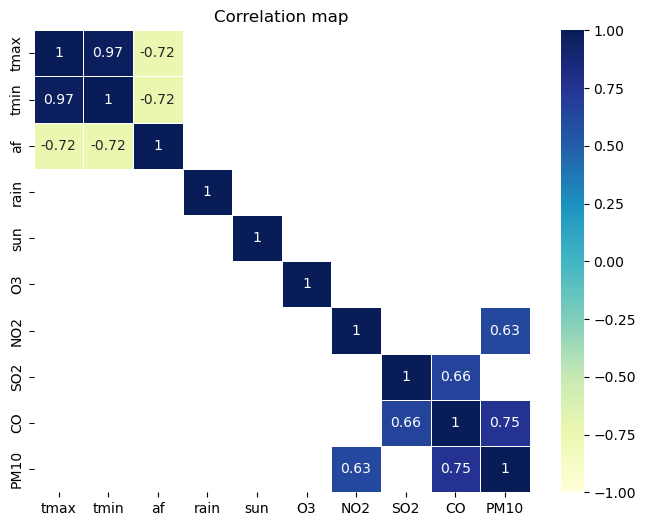

In [57]:
# Checking for collinearity amongst the independant variables
full_df_ind = full_df.drop(columns=['Butterflies_per_Survey'])

# Displaying only strong correlations above 0.6 or below -0.6
Corr = full_df_ind.corr()
Corr_1 = np.squeeze(np.asarray(Corr))
mask = np.zeros(full_df_ind.corr().shape)

for i in range(len(Corr)):
    for j in range(len(Corr)):
        if ((Corr_1[i][j] > -0.6) & (Corr_1[i][j] < 0.6)):
            mask[i][j] = 1

# Plot
plt.figure(figsize=(8,6))
sns.heatmap(Corr, vmin = -1, vmax = 1, cmap = 'YlGnBu', annot = True, mask = mask, linewidth=0.5)
plt.title('Correlation map')
plt.show()

__COMMENT:__ 

- tmax and tmin have a very strong correlation, we will drop one of them
- Other variables seem to have a somewhat strong correlation as well:
    - af and tmax/tmin
    - PM10 and NO2/CO

We will drop tmin and keep the rest for now. At this stage it is a bit early to drop on or the other in the context of the target variable as the number of lags might have an impact on the stregnth of the relationship with Butterflies_per_Survey.

In [58]:
full_df2 = full_df.drop(columns=['tmin'])

### Stationarity

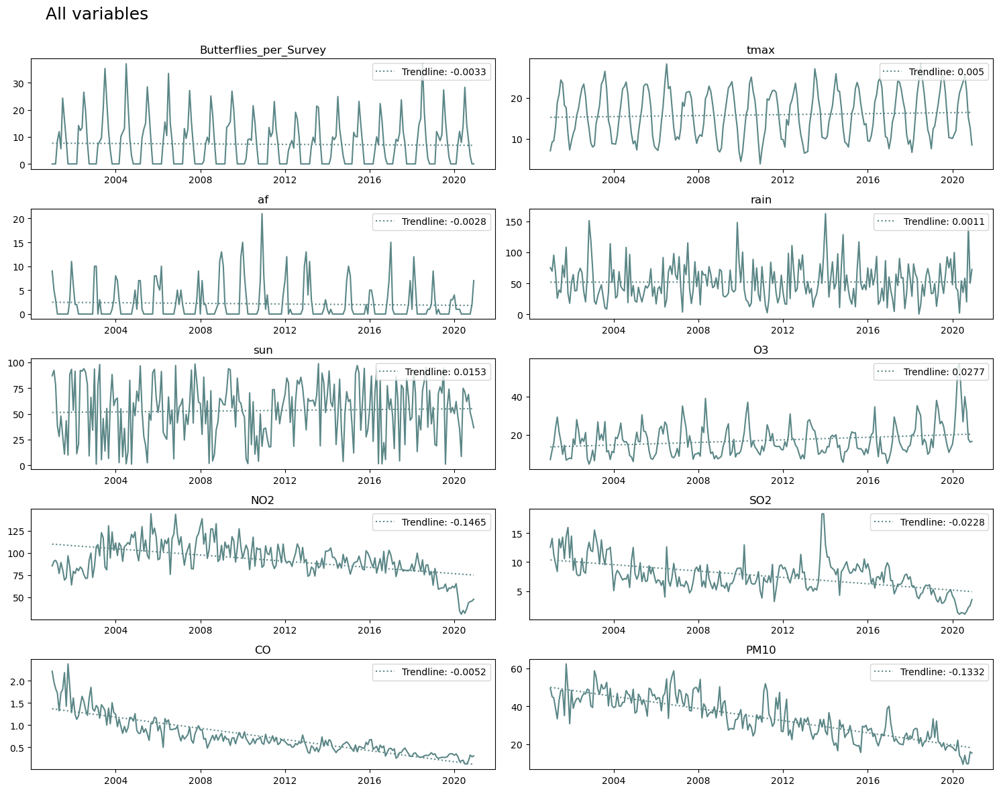

In [60]:
full_df3_for_stationarity = full_df2.copy()

# Add Order info for linear regression (instead of datetime)
full_df3_for_stationarity['Order'] = range(len(full_df3_for_stationarity))

# Plot all variables with trendlines together
cols = full_df3_for_stationarity.columns
fig, axs = plt.subplots(5,2, figsize=(15,12))

for col, ax in zip(cols, axs.ravel()):
    # Get Trendline
    X = full_df3_for_stationarity['Order']
    y = full_df3_for_stationarity[col]
    Trendline = sm.OLS(y.values, sm.add_constant(X.values), missing='drop').fit()
    
    ax.plot(full_df3_for_stationarity[col], color='#5b8686')
    ax.plot(full_df3_for_stationarity.index, Trendline.predict(), color='#5b8686', linestyle=':', 
            label= f'Trendline: {round(Trendline.params[1],4)}')
    ax.set_title(f'{col}')
    ax.legend(loc='upper right')

fig.suptitle('All variables\n', fontsize=18, x=0.1)
plt.tight_layout()
plt.show()

In [62]:
full_df3_for_stationarity = full_df3_for_stationarity.drop(columns=['Order'])

__COMMENT:__ As some variables are evidently non stationary, we will need to apply a differencing. As we have a yearly seasonality, we will apply a 12 months diff and confirm with a Dickey–Fuller test if the variables are indeed stationary (if pvalue< 0.05, it is the case).

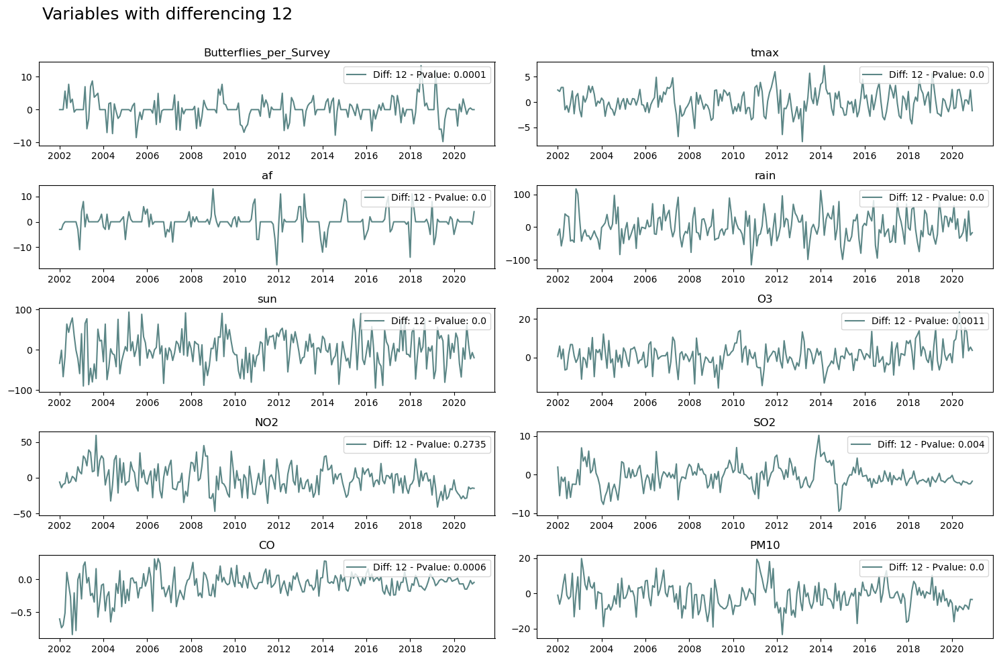

In [63]:
full_df4_diff = full_df3_for_stationarity.copy()

cols = full_df4_diff.columns
fig, axs = plt.subplots(5,2, figsize=(15,10))
diff = 12

for col, ax in zip(cols, axs.ravel()):
    ax.plot(full_df4_diff[col].diff(diff), color='#5b8686', 
            label=f'Diff: {diff} - Pvalue: {round(adfuller(full_df4_diff[col].diff(diff).dropna().values)[1],4)}')
    ax.set_title(f'{col}')
    ax.legend(loc='upper right')
    full_df4_diff[col] = full_df4_diff[col].diff(diff)

fig.suptitle(f'Variables with differencing {diff}\n', fontsize=18, x=0.17)
plt.tight_layout()
plt.show()

__COMMENT:__ Almost all variables are now stationnary except for NO2, but the data plotted seems to be closely aligned with what we need, we will therefore proceed with this.

In [64]:
# Drop row with N/A following differencing
full_df5_st = full_df4_diff.iloc[diff:,:]

### Train/Test Split

In [65]:
# Defining % of data points in the test sets (25%)
nobs = int(len(full_df5_st) - len(full_df5_st)*0.25)

# Creating train and test sets
full_df_st_train = full_df5_st.iloc[:nobs,:]
print(f'Train set shape: {full_df_st_train.shape[0]} rows and {full_df_st_train.shape[1]} columns')

full_df_st_test = full_df5_st.iloc[nobs:,:]
print(f'Test set shape: {full_df_st_test.shape[0]} rows and {full_df_st_test.shape[1]} columns')

Train set shape: 171 rows and 10 columns
Test set shape: 57 rows and 10 columns


### Scale Trends

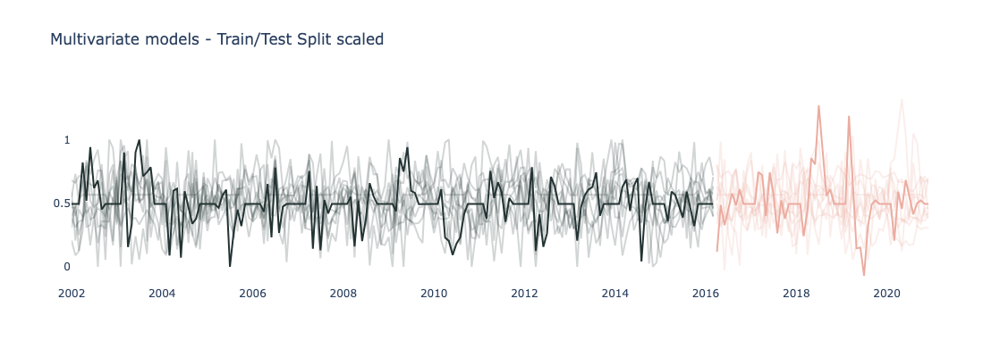

In [66]:
# Fit Scaler
scaler = MinMaxScaler()
scaler.fit(full_df_st_train)

# Transform Train and Test sets
scaled_full_df_train = scaler.transform(full_df_st_train)
scaled_full_df_test = scaler.transform(full_df_st_test)

# Pass scaled data into Dataframe
scaled_full_df_train = pd.DataFrame(columns = ['Butterflies_per_Survey', 'tmax', 'af', 'rain', 'sun', 'O3', 'NO2', 'SO2', 'CO', 'PM10'],
                                    data=scaled_full_df_train, index=full_df_st_train.index)
scaled_full_df_test = pd.DataFrame(columns = ['Butterflies_per_Survey', 'tmax', 'af', 'rain', 'sun', 'O3', 'NO2', 'SO2', 'CO', 'PM10'],
                                   data=scaled_full_df_test, index=full_df_st_test.index)

# Plot Scaled data
fig = go.Figure()

for col in scaled_full_df_train.drop(columns=['Butterflies_per_Survey']):
    fig.add_trace(go.Scatter(x=scaled_full_df_train.index, y=scaled_full_df_train[col], mode='lines', line=dict(color='#233333'), 
                             name=col, opacity = 0.2))

fig.add_trace(go.Scatter(x=scaled_full_df_train.index, y=scaled_full_df_train['Butterflies_per_Survey'], 
                         mode='lines', line=dict(color='#233333'), name='Butterflies', opacity = 1))

for col in scaled_full_df_test.drop(columns=['Butterflies_per_Survey']):
    fig.add_trace(go.Scatter(x=scaled_full_df_test.index, y=scaled_full_df_test[col], mode='lines', line=dict(color='#EBACA0'), 
                             name=col, opacity = 0.2))

fig.add_trace(go.Scatter(x=scaled_full_df_test.index, y=scaled_full_df_test['Butterflies_per_Survey'], 
                         mode='lines', line=dict(color='#EBACA0'), name='Butterflies', opacity = 1))

fig.update_layout(title='Multivariate models - Train/Test Split scaled',
                  width=1150, height=400, plot_bgcolor='white', showlegend=False)
fig.show()

## Finding best parameters

__COMMENT__: We will select here:

- the lowest BIC score for lags order
- the independant variables to be included in the model using a Granger Causality test: the idea is to include only the variables which 'Granger Cause' our target variable 

In [67]:
model = VAR(scaled_full_df_train)
order = model.select_order()
order.summary()

,AIC,BIC,FPE,HQIC
0,-37.91,-37.71*,3.437e-17,-37.83
1,-38.95,-36.81,1.214e-17,-38.08
2,-38.70,-34.61,1.590e-17,-37.04
3,-38.52,-32.49,1.962e-17,-36.07
4,-38.62,-30.64,1.905e-17,-35.38
5,-38.64,-28.71,2.116e-17,-34.61
6,-39.00,-27.12,1.784e-17,-34.17
7,-39.12,-25.29,2.083e-17,-33.50
8,-39.57,-23.80,1.956e-17,-33.17
9,-40.72,-23.00,1.077e-17,-33.52


In [68]:
# Fit model with all variables
results = model.fit(1)

# Testing causality for each variable
print(f'Variables which Granger cause Butterflies_per_Survey:')
print('\n')

for col in scaled_full_df_train.drop(columns=['Butterflies_per_Survey']).columns:
    causality = results.test_causality('Butterflies_per_Survey', [col], kind='wald', signif=0.95)
    
    if causality.pvalue <0.05:
        print(f'{col} - Granger causality test results:')
        print(f'{causality.conclusion_str}{causality.signif_str}')
        print(f'Pvalue: {round(causality.pvalue,4)}')
        print('------------------------')

Variables which Granger cause Butterflies_per_Survey:


rain - Granger causality test results:
Conclusion: reject H_0 at 95% significance level
Pvalue: 0.0208
------------------------
O3 - Granger causality test results:
Conclusion: reject H_0 at 95% significance level
Pvalue: 0.0
------------------------


In [69]:
# Selecting only the variables that are Granger causing Trend_Butterflies_per_Survey
scaled_full_df_train_sel_params = scaled_full_df_train[['Butterflies_per_Survey', 'rain', 'O3']]

## Model

In [70]:
# Final model
model = VAR(scaled_full_df_train_sel_params, freq='MS')
model_fitted = model.fit(1)
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 26, Apr, 2024
Time:                     08:39:46
--------------------------------------------------------------------
No. of Equations:         3.00000    BIC:                   -10.3653
Nobs:                     170.000    HQIC:                  -10.4968
Log likelihood:           188.208    FPE:                2.52511e-05
AIC:                     -10.5867    Det(Omega_mle):     2.35494e-05
--------------------------------------------------------------------
Results for equation Butterflies_per_Survey
                               coefficient       std. error           t-stat            prob
--------------------------------------------------------------------------------------------
const                             0.789193         0.073822           10.690           0.000
L1.Butterflies_per_Survey         0.041819         0.071711            0.583           0

## Evaluation

In [71]:
# Creating predictions
lag_order = model_fitted.k_ar
predictions_var = model_fitted.forecast(y = scaled_full_df_train_sel_params.values[-lag_order:], 
                                steps = len(full_df_st_train) + len(full_df_st_test))

# Extract Butterflies predictions
predictions_butterfly = []

for list in predictions_var:
    predictions_butterfly.append(list[0])

# Pass predictions_butterfly as dataframe
index_preds = full_df2.index.to_numpy()[12:]
predictions_butterfly_df = pd.DataFrame(columns=['predictions_butterfly'], data=predictions_butterfly, index=index_preds)

__COMMENT:__ Our predictions at this stage have scaling and differencing, we will undo that to get the predicted values in our initial unites

In [72]:
########### Unscale predictions ###########

# Shape predictions_butterfly_df for unscaling
for i in range(1,10,1):
    predictions_butterfly_df[i] = 0

# Unscaling
predictions_butterfly_df_unscale = scaler.inverse_transform(predictions_butterfly_df)

# Pass to Dataframe
predictions_butterfly_df_unscale = pd.DataFrame(predictions_butterfly_df_unscale)

# Drop columns 1 - 9, pass as Numpy array
predictions_butterfly_df_unscale = predictions_butterfly_df_unscale[[0]].to_numpy()

# Adding Predictions in the dataset
full_df_preds = full_df2[['Butterflies_per_Survey']]
full_df_preds['Predictions_Diff'] = 0
full_df_preds.iloc[-len(predictions_butterfly_df_unscale):, 1] = predictions_butterfly_df_unscale 

########### Reverse diff Predictions ###########
full_df_preds['Res_Predictions'] = 0

# First values in serie 
first_values_indices = full_df_preds.index[:12]
first_values = full_df_preds.loc[first_values_indices, 'Butterflies_per_Survey']
full_df_preds.loc[first_values_indices, 'Res_Predictions'] = first_values

# Next values
next_indices = predictions_butterfly_df.index
for date in next_indices:
    full_df_preds.loc[date,'Res_Predictions'] = full_df_preds.loc[date,'Predictions_Diff'] + \
                                                              full_df_preds.loc[date - pd.DateOffset(months=12),'Res_Predictions']

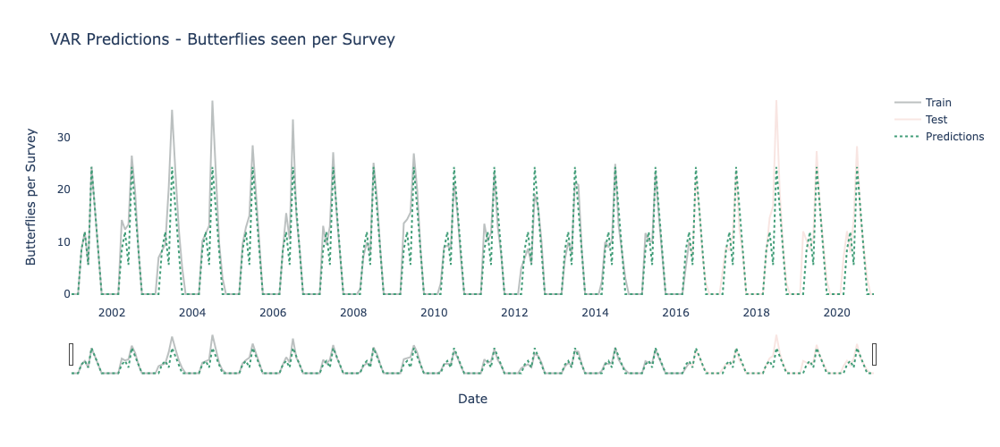

Trendline predictions coeff: -0.0005


Train MAPE on the difference: 15.97%
Test MAPE on the difference: 23.98%
Difference in accuracy between train and test sets: 8.01%


In [73]:
# Add Order info for linear regression
full_df_preds['Order'] = range(len(full_df_preds))

# Make sure no predictions are below 0 (not possible)
full_df_preds['Res_Predictions'] = np.where(full_df_preds['Res_Predictions'] < 0, 0, 
                                            full_df_preds['Res_Predictions'])

#Get Trendline
X = full_df_preds.loc[full_df_st_train.index[13]:, 'Order']
y = full_df_preds.loc[full_df_st_train.index[13]:, 'Res_Predictions']
Trendline = sm.OLS(y.values, sm.add_constant(X.values), missing='drop').fit()

# Split index (train/test)
first_year = full_df_st_train.index[12]
index_split = full_df_st_test.index[1]

# Plotting True values and Predictions
fig = go.Figure()
fig.add_trace(go.Scatter(x=full_df_preds.loc[:index_split,'Butterflies_per_Survey'].index, 
                         y=full_df_preds.loc[:index_split,'Butterflies_per_Survey'], 
                         mode='lines', line=dict(color='#233333'), name='Train', opacity=0.3))
fig.add_trace(go.Scatter(x=full_df_preds.loc[index_split:,'Butterflies_per_Survey'].index, 
                         y=full_df_preds.loc[index_split:,'Butterflies_per_Survey'], 
                         mode='lines', line=dict(color='#EBACA0'), name='Test', opacity=0.3))
fig.add_trace(go.Scatter(x=full_df_preds.index, y=full_df_preds['Res_Predictions'], mode='lines', 
                         line_dash='dot', line=dict(color='#419D78'), name='Predictions'))

fig.update_xaxes(rangeslider_visible=True)

fig.update_layout(yaxis_title='Butterflies per Survey', xaxis_title='Date', 
                  title='VAR Predictions - Butterflies seen per Survey',
                  width=1100, height=500, plot_bgcolor='white', showlegend=True)
fig.show()
print(f'Trendline predictions coeff: {round(Trendline.params[1],4)}')
print('\n')

# Evaluation MAPE
train_mape = mean_absolute_percentage_error(full_df_preds.loc[first_year:index_split,'Butterflies_per_Survey'], 
                                            full_df_preds.loc[first_year:index_split,'Res_Predictions'])
test_mape = mean_absolute_percentage_error(full_df_preds.loc[index_split:,'Butterflies_per_Survey'], 
                                            full_df_preds.loc[index_split:,'Res_Predictions'])
Diff_MAPE = Diff_MAPE_calculation(train_mape, test_mape)

print(f'Train MAPE on the difference: {round(train_mape, 2)}%')
print(f'Test MAPE on the difference: {round(test_mape, 2)}%')
print(f'Difference in accuracy between train and test sets: {round(Diff_MAPE, 2)}%')

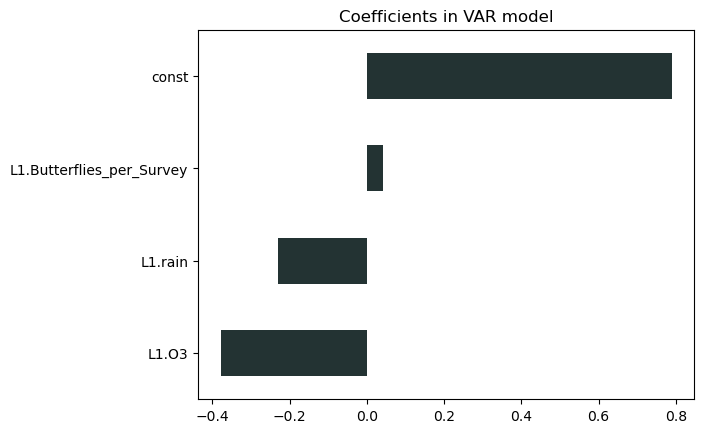

In [74]:
plt.figure()
model_fitted.params['Butterflies_per_Survey'].sort_values(ascending=True).plot(kind='barh', color='#233333')
plt.title('Coefficients in VAR model')
plt.show()

__COMMENT:__ In this model, the rain and ground level ozone have a negative impact on the number of butterflies seen per survey, but the accuracy here is not as good as with the SARIMA model. Also, the predicted values are very constant over the years and do not seem to pick up any trend. We will try to improve the predictions with another model:

# Model 3: Prophet univariate

## Preprocess

In [76]:
full_df_prophet = full_df.copy()
full_df_prophet = full_df_prophet.reset_index().rename(columns={'Year_Month':'ds', 'Butterflies_per_Survey':'y'})

# Creating dataframe for Prophet model (which needs 'ds' and 'y' columns as input)  
df_prophet = full_df_prophet[['ds', 'y']]

In [78]:
# Defining % of data points in the test sets (25%)
nobs = int(len(df_prophet) - len(df_prophet)*0.25)

# Creating train and test sets
df_prophet_train = df_prophet.iloc[:nobs,:]
print(f'Train set shape: {df_prophet_train.shape[0]} rows and {df_prophet_train.shape[1]} columns')

df_prophet_test = df_prophet.iloc[nobs:,:]
print(f'Test set shape: {df_prophet_test.shape[0]} rows and {df_prophet_test.shape[1]} columns')

Train set shape: 180 rows and 2 columns
Test set shape: 60 rows and 2 columns


In [79]:
print(f"First date train set: {df_prophet_train['ds'].min()}")
print(f"Last date train set: {df_prophet_train['ds'].max()}")
print(f"First date test set: {df_prophet_test['ds'].min()}")
print(f"Last date test set: {df_prophet_test['ds'].max()}")

First date train set: 2001-01-01 00:00:00
Last date train set: 2015-12-01 00:00:00
First date test set: 2016-01-01 00:00:00
Last date test set: 2020-12-01 00:00:00


## Model

In [80]:
# Instantiating the model with a few parameters: holidays, weeks and days have no impact on the butterflies sightings
model_prophet = Prophet(n_changepoints=15, yearly_seasonality=True, weekly_seasonality=False, daily_seasonality=False, holidays=None)

# Fitting the model
prophet_fit = model_prophet.fit(df_prophet_train)

08:40:04 - cmdstanpy - INFO - Chain [1] start processing
08:40:04 - cmdstanpy - INFO - Chain [1] done processing


## Evaluation

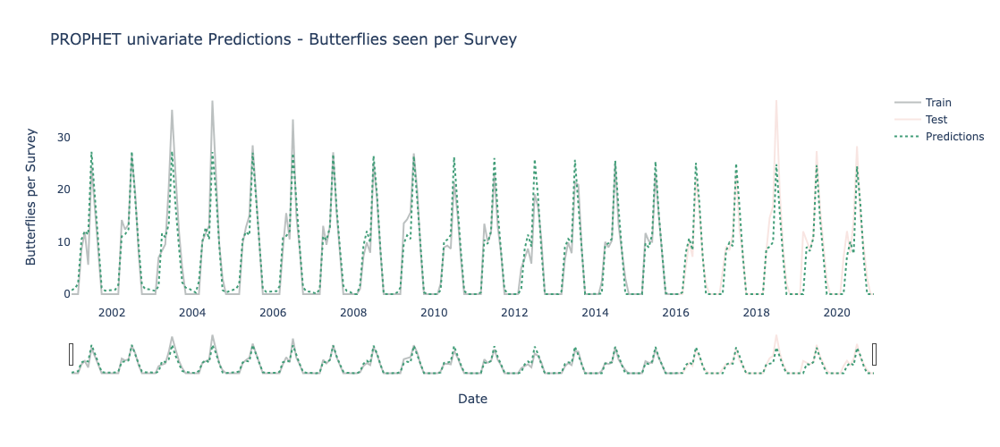

Trendline predictions coeff: -0.0093


Train MAPE on the difference: 11.24%
Test MAPE on the difference: 21.79%
Difference in accuracy between train and test sets: 10.55%


In [81]:
# Predictions on test set
future = model_prophet.make_future_dataframe(periods=len(df_prophet_test), freq='MS')
forecast = model_prophet.predict(future)

# Merge dataset and forecast
observed_forecast_prophet = pd.merge(df_prophet, forecast, left_on='ds', right_on='ds', how='left')

# Make sure no predictions are below 0 (not possible)
observed_forecast_prophet['yhat'] = np.where(observed_forecast_prophet['yhat'] < 0, 0, observed_forecast_prophet['yhat'])


# Add Order info for linear regression
observed_forecast_prophet['Order'] = range(len(observed_forecast_prophet))

#Get Trendline
X = observed_forecast_prophet['Order']
y = observed_forecast_prophet['yhat']
Trendline = sm.OLS(y.values, sm.add_constant(X.values), missing='drop').fit()

# Split index (train/test)
index_split = df_prophet_test.index[1]

# Plotting True values and Predictions
fig = go.Figure()
fig.add_trace(go.Scatter(x=observed_forecast_prophet.loc[:index_split,'ds'], 
                         y=observed_forecast_prophet.loc[:index_split,'y'], 
                         mode='lines', line=dict(color='#233333'), name='Train', opacity=0.3))
fig.add_trace(go.Scatter(x=observed_forecast_prophet.loc[index_split:,'ds'], 
                         y=observed_forecast_prophet.loc[index_split:,'y'], 
                         mode='lines', line=dict(color='#EBACA0'), name='Test', opacity=0.3))
fig.add_trace(go.Scatter(x=observed_forecast_prophet['ds'],
                         y=observed_forecast_prophet['yhat'], mode='lines', 
                         line_dash='dot', line=dict(color='#419D78'), name='Predictions'))

fig.update_xaxes(rangeslider_visible=True)

fig.update_layout(yaxis_title='Butterflies per Survey', xaxis_title='Date', 
                  title='PROPHET univariate Predictions - Butterflies seen per Survey',
                  width=1100, height=500, plot_bgcolor='white', showlegend=True)
fig.show()
print(f'Trendline predictions coeff: {round(Trendline.params[1],4)}')
print('\n')

# Evaluation MAPE
train_mape = mean_absolute_percentage_error(observed_forecast_prophet.loc[:index_split,'y'], 
                                            observed_forecast_prophet.loc[:index_split,'yhat'])
test_mape = mean_absolute_percentage_error(observed_forecast_prophet.loc[index_split:,'y'], 
                                           observed_forecast_prophet.loc[index_split:,'yhat'])
Diff_MAPE = Diff_MAPE_calculation(train_mape, test_mape)

print(f'Train MAPE on the difference: {round(train_mape, 2)}%')
print(f'Test MAPE on the difference: {round(test_mape, 2)}%')
print(f'Difference in accuracy between train and test sets: {round(Diff_MAPE, 2)}%')

__COMMENT:__ the model has a better MAPE score for the train set compared to SARIMA and VAR, however the test set has a lower score compared to SARIMA.

The Difference between train and test is also the worst compared to SARIMA and VAR. We will now try using Prophet with our external factors.

# Model 4: Prophet multivariate - With lags

__COMMENT:__ For this model, we will try something a bit different: observe the impact of external factors on the butterfly population after a year.

We have decided to observe a 12-month period because the life cycle of a butterfly extends from egg to adult in around 4-6 months. As we have sightings data from April to October, we decided that the most interesting approach would be to observe a full year difference.

With this approach, we aim to understand how external factors affect the butterfly population from one generation to the next, with a higher level approach compared to our previous models.

## Preprocess

In [96]:
# Prep dataset
full_df_prophet_lags = full_df_prophet.copy()

# Diff for independant variables: observe impact on butterfly population 12 months after observed values
for col in full_df_prophet_lags.drop(columns=['ds', 'y']).columns:
    full_df_prophet_lags[f'Lag_{col}_12'] = full_df_prophet_lags[col].shift(periods=12)

# Drop missing values after diff
full_df_prophet_lags = full_df_prophet_lags.dropna()
full_df_prophet_lags.head(3)

,ds,y,tmax,tmin,af,rain,sun,O3,NO2,SO2,CO,PM10,Lag_tmax_12,Lag_tmin_12,Lag_af_12,Lag_rain_12,Lag_sun_12,Lag_O3_12,Lag_NO2_12,Lag_SO2_12,Lag_CO_12,Lag_PM10_12
12,2002-01-01,0.0,9.5,3.5,6,51.0,53.4,7.612903,79.344086,14.463710,1.613710,48.438172,7.1,1.8,9.0,75.2,87.0,7.215054,85.311828,12.530914,2.214113,49.475806
13,2002-02-01,0.0,11.3,4.8,2,64.0,91.4,17.955357,76.755952,8.571429,1.238542,38.941964,9.2,2.8,5.0,69.6,92.3,12.074405,90.629464,14.056548,1.972917,45.086310
14,2002-03-01,0.0,12.4,5.1,2,37.6,11.3,14.900538,82.606183,10.627688,1.130645,42.098118,9.5,3.8,3.0,95.3,78.2,15.688172,91.723118,11.280914,1.826882,44.403226


In [97]:
full_df_prophet_lags.columns

Index(['ds', 'y', 'tmax', 'tmin', 'af', 'rain', 'sun', 'O3', 'NO2', 'SO2',
       'CO', 'PM10', 'Lag_tmax_12', 'Lag_tmin_12', 'Lag_af_12', 'Lag_rain_12',
       'Lag_sun_12', 'Lag_O3_12', 'Lag_NO2_12', 'Lag_SO2_12', 'Lag_CO_12',
       'Lag_PM10_12'],
      dtype='object')

In [98]:
# Keeping only lagged columns
full_df_prophet_lags = full_df_prophet_lags[['ds', 'y', 'Lag_tmax_12', 'Lag_tmin_12', 'Lag_af_12', 'Lag_rain_12',
                                             'Lag_sun_12', 'Lag_O3_12', 'Lag_NO2_12', 'Lag_SO2_12', 'Lag_CO_12', 'Lag_PM10_12']]

In [99]:
full_df_prophet_lags_list = ['ds', 'y']

for col in full_df_prophet_lags.drop(columns=['ds', 'y']).columns:
    joh = coint_johansen(full_df_prophet_lags[['y', col]], det_order=-1, k_ar_diff=0)
    tracevalues = joh.lr1
    critical_values = joh.cvt
    diff = tracevalues[1] - critical_values[1, :]
    if (tracevalues[1] > critical_values[1, :]).all():
        print(f"{col}: cointegrated")
        full_df_prophet_lags_list.append(col)
    else:
        print(f"{col} - ")

Lag_tmax_12 - 
Lag_tmin_12: cointegrated
Lag_af_12: cointegrated
Lag_rain_12: cointegrated
Lag_sun_12: cointegrated
Lag_O3_12: cointegrated
Lag_NO2_12 - 
Lag_SO2_12 - 
Lag_CO_12 - 
Lag_PM10_12 - 


In [100]:
full_df_prophet_lags_list

['ds',
 'y',
 'Lag_tmin_12',
 'Lag_af_12',
 'Lag_rain_12',
 'Lag_sun_12',
 'Lag_O3_12']

In [101]:
# Selecting independant variables 
full_df_prophet_lags = full_df_prophet_lags[['ds','y','Lag_tmin_12','Lag_af_12', 'Lag_rain_12','Lag_sun_12','Lag_O3_12']]

## Model

In [102]:
# Instantiate the model
model_prophet_multi = Prophet(yearly_seasonality=True, weekly_seasonality=False, daily_seasonality=False,
                              holidays=None, seasonality_prior_scale=10, changepoint_prior_scale=100)

# Add regressors (independant variables)
for col in full_df_prophet_lags.drop(columns=['y', 'ds']).columns:
    model_prophet_multi.add_regressor(col)

# Train/test Split - Defining % of data points in the test sets (25%)
nobs = int(len(full_df_prophet_lags) - len(full_df_prophet_lags)*0.25)

# Creating train and test sets
full_df_prophet_train = full_df_prophet_lags.iloc[:nobs,:]
print(f'Train set shape: {full_df_prophet_train.shape[0]} rows and {full_df_prophet_train.shape[1]} columns')

full_df_prophet_test = full_df_prophet_lags.iloc[nobs:,:]
print(f'Test set shape: {full_df_prophet_test.shape[0]} rows and {full_df_prophet_test.shape[1]} columns')

# Fit the Model
prophet_fit_multi = model_prophet_multi.fit(full_df_prophet_train)

08:45:01 - cmdstanpy - INFO - Chain [1] start processing
08:45:01 - cmdstanpy - INFO - Chain [1] done processing


Train set shape: 171 rows and 7 columns
Test set shape: 57 rows and 7 columns


## Evaluation

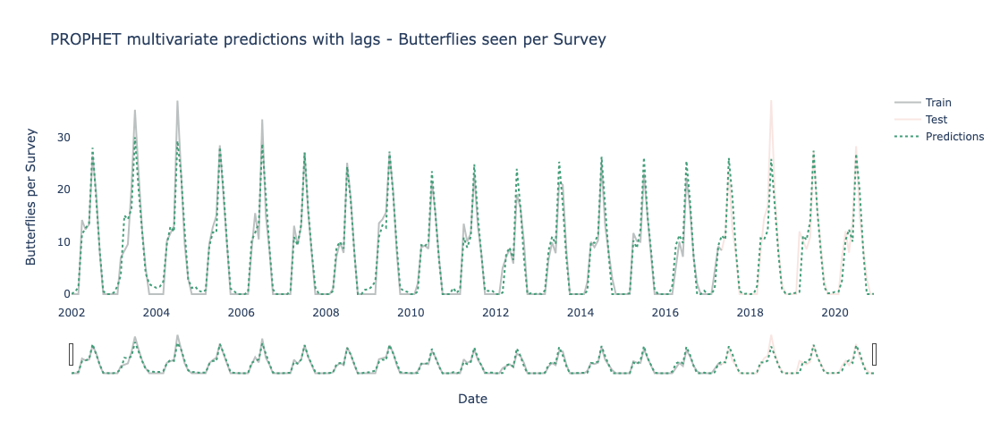

Trendline predictions coeff: -0.007


Train MAPE on the difference: 10.11%
Test MAPE on the difference: 18.48%
Difference in accuracy between train and test sets: 8.37%


In [103]:
# Model predictions
future_multi = model_prophet_multi.make_future_dataframe(periods=len(full_df_prophet_test), freq='MS')
full_future_multi = pd.merge(future_multi, full_df_prophet_lags.drop(columns=['y']), left_on='ds', right_on='ds', how='left')
forecast_multi = model_prophet_multi.predict(full_future_multi)

# Make sure no predictions is below 0 (not possible)
forecast_multi['yhat'] = np.where(forecast_multi['yhat']<0, 0, forecast_multi['yhat'])

# Merge dataset and forecast
observed_forecast_prophet_multi = pd.merge(full_df_prophet_lags, forecast_multi, left_on='ds', right_on='ds', how='left')

# Add Order info for linear regression
observed_forecast_prophet_multi['Order'] = range(len(observed_forecast_prophet_multi))

#Get Trendline
X = observed_forecast_prophet_multi['Order']
y = observed_forecast_prophet_multi['yhat']
Trendline = sm.OLS(y.values, sm.add_constant(X.values), missing='drop').fit()

# Split index (train/test)
index_split = full_df_prophet_test.index[1]

# Plotting True values and Predictions
fig = go.Figure()
fig.add_trace(go.Scatter(x=observed_forecast_prophet_multi.loc[:index_split,'ds'], 
                         y=observed_forecast_prophet_multi.loc[:index_split,'y'], 
                         mode='lines', line=dict(color='#233333'), name='Train', opacity=0.3))
fig.add_trace(go.Scatter(x=observed_forecast_prophet_multi.loc[index_split:,'ds'], 
                         y=observed_forecast_prophet_multi.loc[index_split:,'y'], 
                         mode='lines', line=dict(color='#EBACA0'), name='Test', opacity=0.3))
fig.add_trace(go.Scatter(x=observed_forecast_prophet_multi['ds'],
                         y=observed_forecast_prophet_multi['yhat'], mode='lines', 
                         line_dash='dot', line=dict(color='#419D78'), name='Predictions'))

fig.update_xaxes(rangeslider_visible=True)

fig.update_layout(yaxis_title='Butterflies per Survey', xaxis_title='Date', 
                  title='PROPHET multivariate predictions with lags - Butterflies seen per Survey',
                  width=1100, height=500, plot_bgcolor='white', showlegend=True)
fig.show()
print(f'Trendline predictions coeff: {round(Trendline.params[1],4)}')
print('\n')

# Evaluation MAPE
train_mape = mean_absolute_percentage_error(observed_forecast_prophet_multi.loc[:index_split,'y'], 
                                            observed_forecast_prophet_multi.loc[:index_split,'yhat'])
test_mape = mean_absolute_percentage_error(observed_forecast_prophet_multi.loc[index_split:,'y'], 
                                           observed_forecast_prophet_multi.loc[index_split:,'yhat'])
Diff_MAPE = Diff_MAPE_calculation(train_mape, test_mape)

print(f'Train MAPE on the difference: {round(train_mape, 2)}%')
print(f'Test MAPE on the difference: {round(test_mape, 2)}%')
print(f'Difference in accuracy between train and test sets: {round(Diff_MAPE, 2)}%')

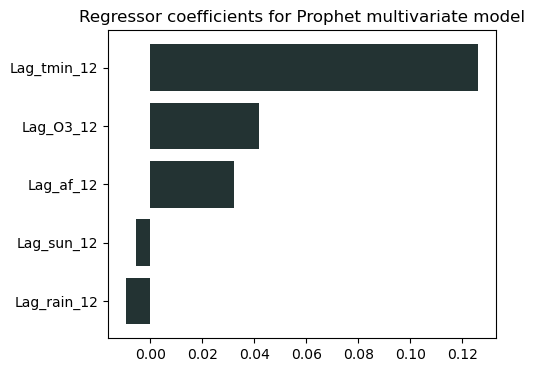

In [104]:
regressor_coef = regressor_coefficients(model_prophet_multi)
regressor_coef = regressor_coef.sort_values(by='coef', ascending=True)

plt.figure(figsize=(5,4))
plt.barh(regressor_coef['regressor'], regressor_coef['coef'], color='#233333')
# plt.xlim((-1,2))
plt.title('Regressor coefficients for Prophet multivariate model')
plt.show()

__COMMENT:__ This model has the best MAPE Scores of all models tried in this notebook and I will retain this one as my baseline model to beat. However, I am not quite happy with the results yet:

- 10% MAPE score on train set and 18% on test set might be improved
- The test set does not quite follow the peaks and drops of the observed data. In particular, the peak in 2018 has not been picked up by the model at all.

At this stage, I am wondering how seasonality still affects the results (even if we lagged the external factors by a year, the temperatures for example still can follow the butterfly line just because both of them have higher values during the summer).

The next steps in the notebook 3 '3_Butterflies_Final model.ipynb' will be to see if we can find a model that works when we remove seasonality and residuals values.